# Section 3.4: Distributed Gradient Descent
###### * Distributed Gradient Descent: The code simulates gradient-based movement with shared direction feedback, conceptually aligning with distributed optimization.

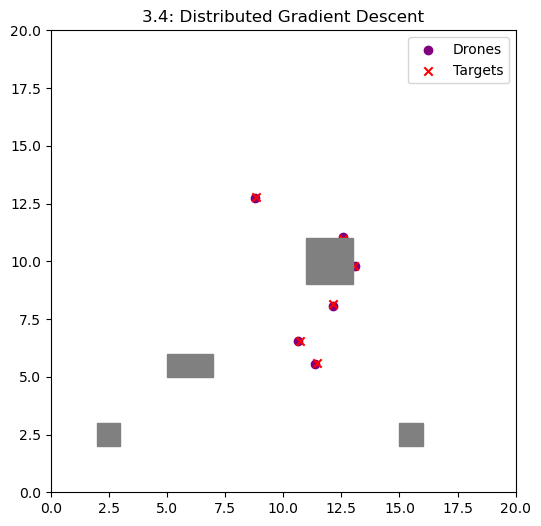

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Polygon
from IPython.display import HTML

# Simulation parameters
n_drones = 6
positions = np.random.rand(n_drones, 2) * 10
targets = np.random.rand(n_drones, 2) * 10 + 5
learning_rate = 0.07
stop_threshold = 0.1

# Obstacles: mix of sparse and dense polygons
obstacles = [
    Polygon([[2,2],[3,2],[3,3],[2,3]], color='gray'),   # Sparse
    Polygon([[5,5],[7,5],[7,6],[5,6]], color='gray'),   # Dense
    Polygon([[11,9],[13,9],[13,11],[11,11]], color='gray'), # Dense
    Polygon([[15,2],[16,2],[16,3],[15,3]], color='gray')  # Sparse
]

# Visualization setup
fig, ax = plt.subplots(figsize=(6,6))
sc = ax.scatter(positions[:,0], positions[:,1], c='purple', label='Drones')
target_sc = ax.scatter(targets[:,0], targets[:,1], c='red', marker='x', label='Targets')
for obs in obstacles:
    ax.add_patch(obs)
ax.set_xlim(0, 20)
ax.set_ylim(0, 20)
ax.legend()
ax.set_title('3.4: Distributed Gradient Descent')

is_paused = False
arrived = np.array([False]*n_drones)

def point_inside_obstacle(point, polygon):
    return polygon.contains_point(point)

def obstacle_repulsion(pos, obstacles):
    repulsion = np.zeros(2)
    for obs in obstacles:
        verts = obs.get_path().vertices
        centroid = np.mean(verts, axis=0)
        vec = pos - centroid
        dist = np.linalg.norm(vec)
        if dist < 3:
            repulsion += vec / (dist + 1e-6) * 0.4
    return repulsion

def update(frame):
    global positions, arrived
    if not is_paused:
        for i in range(n_drones):
            if arrived[i]:
                continue
            # Distributed direction: combine target direction and obstacle repulsion
            direction = targets[i] - positions[i]
            distance = np.linalg.norm(direction)
            if distance < stop_threshold:
                arrived[i] = True
                continue
            direction = direction / (distance + 1e-6)
            repulsion = obstacle_repulsion(positions[i], obstacles)
            total_direction = direction + repulsion
            norm = np.linalg.norm(total_direction)
            if norm > 0:
                positions[i] += learning_rate * total_direction / norm
        sc.set_offsets(positions)
    return sc,

def on_click(event):
    global is_paused
    if event.inaxes is not None:
        is_paused = not is_paused

# Connect click for pause/play
fig.canvas.mpl_connect('button_press_event', on_click)

# Animate
anim = FuncAnimation(fig, update, frames=600, interval=20, blit=True)
HTML(anim.to_jshtml())